In [174]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image
%matplotlib inline
import pandas as pd
import seaborn as sns
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
import plotly.offline as py
py.init_notebook_mode(connected =True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

## Data

In [175]:
child = pd.read_csv('ch1fulldata.csv')

In [176]:
child.head()

,LN,UF1,UF2,UF3,UFINT,UF4,UF5,UF6,UF7D,UF7M,...,CAGE_11,division,majorcity,hh6r,hh7,mlevel,cdisability,caretakerdis,chweight,UCD2B
0,4,1,14,4,203,2,203,2,18,12,...,5,1,2,2,1,1,2,7,0,2
1,5,1,18,5,207,1,207,2,18,12,...,3,1,2,2,1,0,2,2,2,2
2,4,1,9,4,203,2,203,2,18,12,...,4,1,2,2,1,0,2,2,2,2
3,3,1,9,3,203,2,203,2,18,12,...,5,1,2,2,1,0,2,2,2,2
4,5,1,11,5,207,2,207,2,18,12,...,3,1,2,2,1,1,2,2,2,2


## 1.1 Data overview

In [177]:
print("Rows:" ,child.shape[0])
print("Columns:",child.shape[1])
print("\nFeatures: \n" ,child.columns.tolist())
print("\nMissing values: ",child.isnull().sum().values.sum())
print("\nUnique values : \n", child.nunique())

Rows: 25462
Columns: 109

Features: 
 ['LN', 'UF1', 'UF2', 'UF3', 'UFINT', 'UF4', 'UF5', 'UF6', 'UF7D', 'UF7M', 'UF7Y', 'UF9', 'UF10', 'UF17', 'UF8H', 'UF8M', 'UF11H', 'UF11M', 'UF12', 'UF13', 'UF14', 'UF15', 'UFHINT', 'UB1D', 'UB1M', 'UB1Y', 'UB2', 'UB6', 'UB7', 'UB8', 'EC1', 'EC2A', 'EC2B', 'EC2C', 'EC3A', 'EC3B', 'EC6', 'EC7', 'EC8', 'EC9', 'EC10', 'EC11', 'EC12', 'EC13', 'EC14', 'EC15', 'UCD2A', 'UCD2C', 'UCD2D', 'UCD2E', 'UCD2F', 'UCD2G', 'UCD2H', 'UCD2I', 'UCD2J', 'UCD2K', 'UCD5', 'UCF2', 'UCF3', 'UCF4', 'UCF7', 'UCF9', 'UCF11', 'UCF12', 'UCF13', 'UCF14', 'UCF15', 'UCF16', 'UCF17', 'UCF18', 'UCF19', 'BD2', 'BD3', 'IM2', 'IM3', 'IM5', 'IM8', 'AN1', 'AN2', 'AN3', 'AN4', 'AN5', 'AN6', 'AN8', 'AN9', 'AN11', 'AN12', 'AN13D', 'AN13M', 'AN13Y', 'HH4', 'HH6', 'HL4', 'ED5A', 'ED5B', 'CDOI', 'CDOB', 'CAGE', 'CAGE_6', 'CAGE_11', 'division', 'majorcity', 'hh6r', 'hh7', 'mlevel', 'cdisability', 'caretakerdis', 'chweight', 'UCD2B']

Missing values:  0

Unique values : 
 LN                37
UF

# 2. Data Manipulation

In [178]:
#Data Manipulation

#Replacing spaces with null values in total charges column
child['UF1']=child["UF1"].replace(" ",np.nan)
#Dropping null values from total charges column which contain .15% missing data 
child = child[child["UF1"].notnull()]
child = child.reset_index()[child.columns]
#convert to float type
child["UF1"] =child["UF1"].astype(float)
#replace values
child["UCD2B"] = child["UCD2B"].replace({1:"Wrong Behavior" ,2:"True Behavior"})
#Seprating Normal and Abnormal Behavior of child
normal =child[child["UCD2B"] =="True Behavior"]
Abnormal =child[child["UCD2B"] =="Wrong Behavior"]
#Separating catagorical and numerical customers
Id_col = ['UF1']
target_col = ["UCD2B"]
cat_cols = child.nunique()[child.nunique() < 6].keys().tolist()
cat_cols = [x for x in cat_cols if x not in target_col]
num_cols = [x for x in child.columns if x not in cat_cols + target_col + Id_col]

# 3.Exploratory Data Analysis
### 3.1 Child discipline in data

In [179]:
#labels
lab = child["UCD2B"].value_counts().keys().tolist()
#values
val = child["UCD2B"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'lime'],
                             line = dict(color = "white",
                                         width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Child discipline factor  in data",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

## 3.2. Varibles distribution in Child discipline

In [180]:
#function  for pie plot for child behavior types
def plot_pie(column) :
    
    trace1 = go.Pie(values  = normal[column].value_counts().values.tolist(),
                    labels  = normal[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    domain  = dict(x = [0,.48]),
                    name    = "Normal child",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    hole    = .6
                   )
    trace2 = go.Pie(values  = Abnormal[column].value_counts().values.tolist(),
                    labels  = Abnormal[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    domain  = dict(x = [.52,1]),
                    hole    = .6,
                    name    = "Anormal child" 
                   )


    layout = go.Layout(dict(title = column + " distribution in behavior Problem ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            annotations = [dict(text = "normal",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .15, y = .5),
                                           dict(text = "Abnormal",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .88,y = .5
                                               )
                                          ]
                           )
                      )
    data = [trace1,trace2]
    fig  = go.Figure(data = data,layout = layout)
    py.iplot(fig)
for i in cat_cols :
    plot_pie(i)


In [181]:
#function  for histogram for child behavior types
def histogram(column) :
    trace1 = go.Histogram(x  = normal[column],
                          histnorm= "percent",
                          name = "normal",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = Abnormal[column],
                          histnorm = "percent",
                          name = "Abormal",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution in child behavior problem ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    py.iplot(fig)
for i in num_cols :
    histogram(i)   

## Child Behavior with age group

In [182]:
#cusomer attrition in age groups
tg_ch  =  normal["UB2"].value_counts().reset_index()
tg_ch.columns  = ["UB2","count"]
tg_nch =  Abnormal["UB2"].value_counts().reset_index()
tg_nch.columns = ["UB2","count"]

#bar - normal
trace1 = go.Bar(x = tg_ch["UB2"]  , y = tg_ch["count"],
                name = "Normal child",
                marker = dict(line = dict(width = .02,color = "black")),
                opacity = .9)

#bar - abnormal
trace2 = go.Bar(x = tg_nch["UB2"] , y = tg_nch["count"],
                name = "Abnormal child",
                marker = dict(line = dict(width = .02,color = "black")),
                opacity = .9)

layout = go.Layout(dict(title = "Child behavior  in different age groups",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "age group",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "count",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                       )
                  )
data = [trace1,trace2]
fig  = go.Figure(data=data,layout=layout)
py.iplot(fig)

### 3.4. Districts hh7 and  by age UB2 and behavior 

## 4. Data preprocessing

In [183]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

In [184]:
#customer id col
Id_col     = ['UF1']
#Target columns
target_col = ["UCD2B"]
#categorical columns
cat_cols   = child.nunique()[child.nunique() < 6].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
#numerical columns
num_cols   = [x for x in child.columns if x not in cat_cols + target_col + Id_col]
#Binary columns with 2 values
bin_cols   = child.nunique()[child.nunique() == 2].keys().tolist()
#Columns more than 2 values
multi_cols = [x for x in cat_cols if x not in bin_cols]


In [185]:
#Label encoding Binary columns
le = LabelEncoder()
for i in bin_cols :
    child[i] = le.fit_transform(child[i])
    
#Duplicating columns for multi value columns
child = pd.get_dummies(data = child,columns = multi_cols )

#Scaling Numerical columns
std = StandardScaler()
scaled = std.fit_transform(child[num_cols])
scaled = pd.DataFrame(scaled,columns=num_cols)

#dropping original values merging scaled values for numerical columns
df_child_og = child.copy()
child= child.drop(columns = num_cols ,axis = 1)
child = child.merge(scaled,left_index=True,right_index=True,how = "left")

## Variable summary

In [186]:
summary = (df_child_og[[i for i in df_child_og.columns if i not in Id_col]].
           describe().transpose().reset_index())

summary = summary.rename(columns = {"index" : "feature"})
summary = np.around(summary,3)

val_lst = [summary['feature'], summary['count'],
           summary['mean'],summary['std'],
           summary['min'], summary['25%'],
           summary['50%'], summary['75%'], summary['max']]

trace  = go.Table(header = dict(values = summary.columns.tolist(),
                                line = dict(color = ['#506784']),
                                fill = dict(color = ['#119DFF']),
                               ),
                  cells  = dict(values = val_lst,
                                line = dict(color = ['#506784']),
                                fill = dict(color = ["lightgrey",'#F5F8FF'])
                               ),
                  columnwidth = [200,60,100,100,60,60,80,80,80])
layout = go.Layout(dict(title = "Variable Summary"))
figure = go.Figure(data=[trace],layout=layout)
py.iplot(figure)

### 3.8. Correlation matrix

In [187]:
#correlation
correlation = child.corr()
#tick labels
matrix_cols = correlation.columns.tolist()
#convert to array
corr_array  = np.array(correlation)

#Plotting
trace = go.Heatmap(z = corr_array,
                   x = matrix_cols,
                   y = matrix_cols,
                   colorscale = "Viridis",
                   colorbar   = dict(title = "Pearson Correlation coefficient",
                                     titleside = "right"
                                    ) ,
                  )

layout = go.Layout(dict(title = "Correlation Matrix for variables",
                        autosize = False,
                        height  = 720,
                        width   = 800,
                        margin  = dict(r = 0 ,l = 210,
                                       t = 25,b = 210,
                                      ),
                        yaxis   = dict(tickfont = dict(size = 9)),
                        xaxis   = dict(tickfont = dict(size = 9))
                       )
                  )

data = [trace]
fig = go.Figure(data=data,layout=layout)
py.iplot(fig)

### 3.9. Visualising data with principal components

In [188]:
from sklearn.decomposition import PCA

pca = PCA(n_components = 2)

X = child[[i for i in child.columns if i not in Id_col + target_col]]
Y = child[target_col + Id_col]

principal_components = pca.fit_transform(X)
pca_data = pd.DataFrame(principal_components,columns = ["PC1","PC2"])
pca_data = pca_data.merge(Y,left_index=True,right_index=True,how="left")
pca_data["UCD2B"] = pca_data["UCD2B"].replace({1:"Wrong Behavior",0:"True Behavior"})

def pca_scatter(target,color) :
    tracer = go.Scatter(x = pca_data[pca_data["UCD2B"] == target]["PC1"] ,
                        y = pca_data[pca_data["UCD2B"] == target]["PC2"],
                        name = target,mode = "markers",
                        marker = dict(color = color,
                                      line = dict(width = .5),
                                      symbol =  "diamond-open"),
                        
                       )
    return tracer

layout = go.Layout(dict(title = "Visualising data with principal components",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "principal component 1",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "principal component 2",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                        height = 600
                       )
                  )
trace1 = pca_scatter("True Behavior",'red')
trace2 = pca_scatter("Wrong Behavior",'royalblue')
data = [trace2,trace1]
fig = go.Figure(data=data,layout=layout)
py.iplot(fig)

## 3.10. Binary variables distribution in child behavior (Radar Chart)

In [189]:
#separating binary columns
bi_cs = child.nunique()[child.nunique() == 2].keys()
dat_rad = child[bi_cs]

#plotting radar chart for churn and non churn customers(binary variables)
def plot_radar(df,aggregate,title) :
    data_frame = df[df["HL4"] == aggregate] 
    data_frame_x = data_frame[bi_cs].sum().reset_index()
    data_frame_x.columns  = ["feature","yes"]
    data_frame_x["no"]    = data_frame.shape[0]  - data_frame_x["yes"]
    data_frame_x  = data_frame_x[data_frame_x["feature"] != "HL4"]
    
    #count of 1's(yes)
    trace1 = go.Scatterpolar(r = data_frame_x["yes"].values.tolist(),
                             theta = data_frame_x["feature"].tolist(),
                             fill  = "toself",name = "count of 0's",
                             mode = "markers+lines",
                             marker = dict(size = 5)
                            )
    #count of 2's(No)
    trace2 = go.Scatterpolar(r = data_frame_x["no"].values.tolist(),
                             theta = data_frame_x["feature"].tolist(),
                             fill  = "toself",name = "count of 1's",
                             mode = "markers+lines",
                             marker = dict(size = 5)
                            ) 
    layout = go.Layout(dict(polar = dict(radialaxis = dict(visible = True,
                                                           side = "counterclockwise",
                                                           showline = True,
                                                           linewidth = 2,
                                                           tickwidth = 2,
                                                           gridcolor = "white",
                                                           gridwidth = 2),
                                         angularaxis = dict(tickfont = dict(size = 10),
                                                            layer = "below traces"
                                                           ),
                                         bgcolor  = "rgb(243,243,243)",
                                        ),
                            paper_bgcolor = "rgb(243,243,243)",
                            title = title,height = 700))
    
    data = [trace2,trace1]
    fig = go.Figure(data=data,layout=layout)
    py.iplot(fig)

#plot
plot_radar(dat_rad,1,"Male -  Child")
plot_radar(dat_rad,2,"Female - Child")

# 5. Model Building

### 5.1. Baseline Model

In [190]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,accuracy_score,classification_report
from sklearn.metrics import roc_auc_score,roc_curve,scorer
from sklearn.metrics import f1_score
import statsmodels.api as sm
from sklearn.metrics import precision_score,recall_score
from yellowbrick.classifier import DiscriminationThreshold

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='ovr', n_jobs=1, penalty='l2', random_state=None,
                   solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

 Classification report : 
               precision    recall  f1-score   support

           0       0.69      0.63      0.66      2348
           1       0.80      0.83      0.81      4018

    accuracy                           0.76      6366
   macro avg       0.74      0.73      0.74      6366
weighted avg       0.76      0.76      0.76      6366

Accuracy   Score :  0.7584040213634936
Area under curve :  0.7324065767080505 



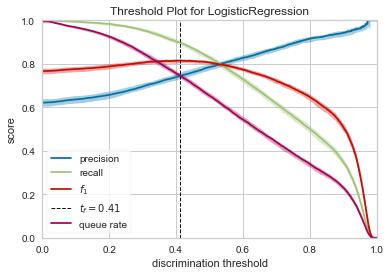

In [191]:
#splitting train and test data 
train,test = train_test_split(child,test_size = .25 ,random_state = 111)
    
##seperating dependent and independent variables
cols    = [i for i in child.columns if i not in Id_col + target_col]
train_X = train[cols]
train_Y = train[target_col]
test_X  = test[cols]
test_Y  = test[target_col]

#Function attributes
#dataframe     - processed dataframe
#Algorithm     - Algorithm used 
#training_x    - predictor variables dataframe(training)
#testing_x     - predictor variables dataframe(testing)
#training_y    - target variable(training)
#training_y    - target variable(testing)
#cf - ["coefficients","features"](cooefficients for logistic 
                                 #regression,features for tree based models)

#threshold_plot - if True returns threshold plot for model
    
def child_behavior_prediction(algorithm,training_x,testing_x,
                             training_y,testing_y,cols,cf,threshold_plot) :
    
    #model
    algorithm.fit(training_x,training_y)
    predictions   = algorithm.predict(testing_x)
    probabilities = algorithm.predict_proba(testing_x)
    #coeffs
    if   cf == "coefficients" :
        coefficients  = pd.DataFrame(algorithm.coef_.ravel())
    elif cf == "features" :
        coefficients  = pd.DataFrame(algorithm.feature_importances_)
        
    column_df     = pd.DataFrame(cols)
    coef_sumry    = (pd.merge(coefficients,column_df,left_index= True,
                              right_index= True, how = "left"))
    coef_sumry.columns = ["coefficients","features"]
    coef_sumry    = coef_sumry.sort_values(by = "coefficients",ascending = False)
    
    print (algorithm)
    print ("\n Classification report : \n",classification_report(testing_y,predictions))
    print ("Accuracy   Score : ",accuracy_score(testing_y,predictions))
    #confusion matrix
    conf_matrix = confusion_matrix(testing_y,predictions)
    #roc_auc_score
    model_roc_auc = roc_auc_score(testing_y,predictions) 
    print ("Area under curve : ",model_roc_auc,"\n")
    fpr,tpr,thresholds = roc_curve(testing_y,probabilities[:,1])
    
    #plot confusion matrix
    trace1 = go.Heatmap(z = conf_matrix ,
                        x = ["Abnormal","Normal"],
                        y = ["Abnormal","Normal"],
                        showscale  = False,colorscale = "Picnic",
                        name = "matrix")
    
    #plot roc curve
    trace2 = go.Scatter(x = fpr,y = tpr,
                        name = "Roc : " + str(model_roc_auc),
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2))
    trace3 = go.Scatter(x = [0,1],y=[0,1],
                        line = dict(color = ('rgb(205, 12, 24)'),width = 2,
                        dash = 'dot'))
    
    #plot coeffs
    trace4 = go.Bar(x = coef_sumry["features"],y = coef_sumry["coefficients"],
                    name = "coefficients",
                    marker = dict(color = coef_sumry["coefficients"],
                                  colorscale = "Picnic",
                                  line = dict(width = .6,color = "black")))
    
    #subplots
    fig = tls.make_subplots(rows=2, cols=2, specs=[[{}, {}], [{'colspan': 2}, None]],
                            subplot_titles=('Confusion Matrix',
                                            'Receiver operating characteristic curve',
                                            'Feature Importances'))
    
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,1,2)
    fig.append_trace(trace4,2,1)
    
    fig['layout'].update(showlegend=False, title="Model performance" ,
                         autosize = False,height = 900,width = 800,
                         plot_bgcolor = 'rgba(240,240,240, 0.95)',
                         paper_bgcolor = 'rgba(240,240,240, 0.95)',
                         margin = dict(b = 195))
    fig["layout"]["xaxis2"].update(dict(title = "false positive rate"))
    fig["layout"]["yaxis2"].update(dict(title = "true positive rate"))
    fig["layout"]["xaxis3"].update(dict(showgrid = True,tickfont = dict(size = 10),
                                        tickangle = 90))
    py.iplot(fig)
    
    if threshold_plot == True : 
        visualizer = DiscriminationThreshold(algorithm)
        visualizer.fit(training_x,training_y)
        visualizer.poof()
        
logit  = LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

child_behavior_prediction(logit,train_X,test_X,train_Y,test_Y,
                         cols,"coefficients",threshold_plot = True)

# 5.2. Synthetic Minority Oversampling TEchnique (SMOTE)
* Randomly pick a point from the minority class.

* Compute the k-nearest neighbors (for some pre-specified k) for this point.

* Add k new points somewhere between the chosen point and each of its neighbors

In [205]:
from imblearn.over_sampling import SMOTE

cols    = [i for i in child.columns if i not in Id_col+target_col]

smote_X = child[cols]
smote_Y = child[target_col]

#Split train and test data
smote_train_X,smote_test_X,smote_train_Y,smote_test_Y = train_test_split(smote_X,smote_Y,
                                                                         test_size = .25 ,
                                                                         random_state = 111)

#oversampling minority class using smote
os = SMOTE(random_state = 0)
os_smote_X,os_smote_Y = os.fit_sample(smote_train_X,smote_train_Y)
os_smote_X = pd.DataFrame(data = os_smote_X,columns=cols)
os_smote_Y = pd.DataFrame(data = os_smote_Y,columns=target_col)
###



logit_smote = LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

telecom_churn_prediction(logit_smote,os_smote_X,test_X,os_smote_Y,test_Y,
                         cols,"coefficients",threshold_plot = True)

AttributeError: 'DataFrame' object has no attribute 'name'

In [192]:
from imblearn.over_sampling import RandomOverSampler

In [193]:
ros = RandomOverSampler(random_state=0)

In [196]:
ros = RandomOverSampler(random_state=0)

## 5.3. Recursive Feature Elimination
Recursive Feature Elimination (RFE) is based on the idea to repeatedly construct a model and choose either the best or worst performing feature, setting the feature aside and then repeating the process with the rest of the features. This process is applied until all features in the dataset are exhausted. The goal of RFE is to select features by recursively considering smaller and smaller sets of features.

In [154]:
from sklearn.feature_selection import RFE

logit = LogisticRegression()

rfe = RFE(logit,10)
rfe = rfe.fit(os_smote_X,os_smote_Y.values.ravel())

rfe.support_
rfe.ranking_

#identified columns Recursive Feature Elimination
idc_rfe = pd.DataFrame({"rfe_support" :rfe.support_,
                       "columns" : [i for i in telcom.columns if i not in Id_col + target_col],
                       "ranking" : rfe.ranking_,
                      })
cols = idc_rfe[idc_rfe["rfe_support"] == True]["columns"].tolist()


#separating train and test data
train_rf_X = os_smote_X[cols]
train_rf_Y = os_smote_Y
test_rf_X  = test[cols]
test_rf_Y  = test[target_col]

logit_rfe = LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)
#applying model
telecom_churn_prediction(logit_rfe,train_rf_X,test_rf_X,train_rf_Y,test_rf_Y,
                         cols,"coefficients",threshold_plot = True)

tab_rk = ff.create_table(idc_rfe)
py.iplot(tab_rk)

NameError: name 'os_smote_X' is not defined